In [2]:
from sentinelhub import SHConfig
config = SHConfig()

if not config.sh_client_id or not config.sh_client_secret:
    print("Warning! To use Process API, please provide the credentials (OAuth client ID and client secret).")

import datetime
import os
import matplotlib.patches as patches

import matplotlib.pyplot as plt
import numpy as np

from sentinelhub import (
    CRS,
    BBox,
    DataCollection,
    DownloadRequest,
    MimeType,
    MosaickingOrder,
    SentinelHubDownloadClient,
    SentinelHubRequest,
    bbox_to_dimensions,
)

### Evalscripts for sentinelhub API

These are the javascript(?) functions that are used to get data from the sentinelhub API.

In [3]:
evalscript_all_bands = """
    //VERSION=3
    function setup() {
        return {
            input: [{
                bands: ["B01","B02","B03","B04","B05","B06","B07","B08","B8A","B09","B10","B11","B12","CLM"],
                units: "DN"
            }],
            output: {
                bands: 13,
                sampleType: "INT16"
            }
        };
    }

    function evaluatePixel(sample) {
        return [sample.B01,
                sample.B02,
                sample.B03,
                sample.B04,
                sample.B05,
                sample.B06,
                sample.B07,
                sample.B08,
                sample.B8A,
                sample.B09,
                sample.B10,
                sample.B11,
                sample.B12,
                sample.CLM];
    }
"""

evalscript_clm = """
//VERSION=3
function setup() {
  return {
    input: ["CLM"],
    output: { bands: 1 }
  }
}

function evaluatePixel(sample) {
  return [sample.CLM];
}
"""

evalscript_rgb = """
//VERSION=3
function setup() {
  return {
    input: ["B04", "B03", "B02"],
    output: { bands: 3 }
  }
}

function evaluatePixel(sample) {
  return [sample.B04, sample.B03, sample.B02];
}
"""


### Low resoultion plotting

This is the plot of the whole region, with 100m resoultion; as the download size in naturally limited by the sentinelhub api, we need to find a way around that. This will be shown further down. The plot below corresponds to the downloads of `s2_download.py`. 

Image shape at 100 m resolution: (1157, 773) pixels


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


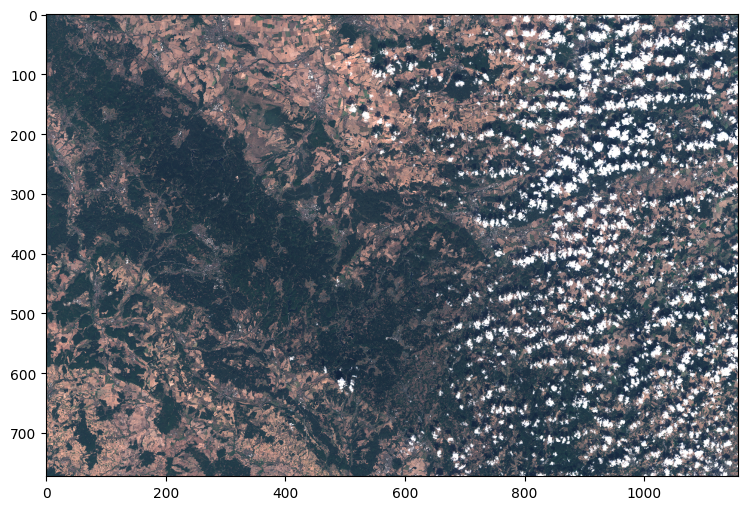

In [17]:
bbox = [10.294189,50.307024,11.961365,50.972242]
resolution = 100

frankenwald_bbox = BBox(bbox=bbox, crs=CRS.WGS84)
frankenwald_size = bbox_to_dimensions(frankenwald_bbox, resolution=resolution)

print(f"Image shape at {resolution} m resolution: {frankenwald_size} pixels")

request_true_color = SentinelHubRequest(
    data_folder="/home/josh/Desktop/S2_Frankenwald/",
    evalscript=evalscript_rgb,
    input_data=[
        SentinelHubRequest.input_data(
            data_collection=DataCollection.SENTINEL2_L1C,
            #mosaicking_order=MosaickingOrder.LEAST_CC,
            time_interval=("2022-08-18", "2022-08-25"),
        )
    ],
    responses=[SentinelHubRequest.output_response("default", MimeType.TIFF)],
    bbox=frankenwald_bbox,
    size=frankenwald_size,
    config=config,
)

true_color_imgs = request_true_color.get_data(save_data=False)
plt.figure(figsize=(10, 6))
plt.imshow(true_color_imgs[0] / 255 * 3.5)

In [4]:
path = '/work/users/jn906hluu/S2_Frankenwald_quartal/'
list_dir = os.listdir(path)
shape_file_path = '/work/users/jn906hluu/RSP/ForestCoverPatternStudy/Layers/D48/D48.shp'

quicklook_dir = '/work/users/jn906hluu/to_gif_quartal/'

folder = list_dir[22]
    
image_path = path + folder + '/response.tiff'

In [13]:
bbox = [10.294189,50.307024,11.961365,50.972242]
resolution = 10

frankenwald_bbox = BBox(bbox=bbox, crs=CRS.WGS84)
frankenwald_size = bbox_to_dimensions(frankenwald_bbox, resolution=resolution)

print(f"Image shape at {resolution} m resolution: {frankenwald_size} pixels")

#ratio = (bbox[2] - bbox[0]) / (bbox[3] - bbox[1])
#print(f"The ratio of width/height is {ratio}")

Image shape at 10 m resolution: (11575, 7734) pixels


### Visualizing the mosaic

To visualize how we have to arrange the mosaic, i plotted it here; actually this will be made unnecessary by the rasterio.merge function, as the boundaries of every file are stored in the .tif; Still I consider it a good practice if one would need to implement it once manually. 

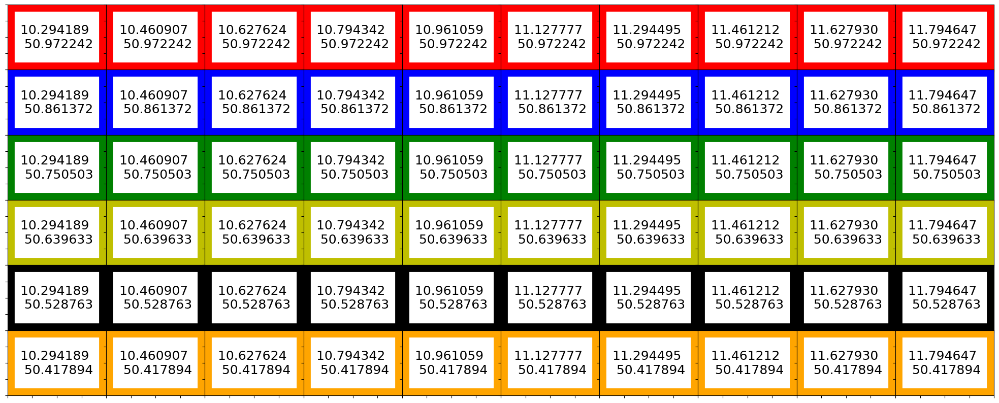

In [14]:
bbox = [10.294189,50.307024,11.961365,50.972242]

x_coords = np.linspace(bbox[0], bbox[2], 11)
y_coords = np.linspace(bbox[3], bbox[1], 7)   #ordering needs to be reversed

list_of_bbox = np.zeros((10, 6, 4))

for i in range(10):
    for j in range(6):
        list_of_bbox[i,j, :] = [x_coords[i], y_coords[j], x_coords[i+1], y_coords[j+1]]

colors = ['r', 'b', 'g', 'y', 'k', 'orange']

size = 10
f, axarr = plt.subplots(6, 10, gridspec_kw = {'wspace':0, 'hspace':0}, figsize=(size * ratio, size))

def rect(color):
    return patches.Rectangle((0, 0), 1, 1, linewidth=20, edgecolor=color, facecolor='none')


for i in range(10):
    for j in range(6):
        ax = axarr[j, i]
        #ax.grid('off')
        color = colors[j]
        ax.set_xticklabels([])
        ax.set_yticklabels([])  
        ax.add_patch(rect(color))
        text = ax.text(0.5, 0.5, f'{list_of_bbox[i,j, 0]:.6f} \n {list_of_bbox[i,j, 1]:.6f}',
            ha="center", va="center", color="k", fontsize=18) 


### Plotting of the mosaic

This is the HD Mosaic, consiting of 60 1500 x 2000 individual s2-images. This plots corresponds to the output of the `s2_download_hd.py`.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

<Figure size 640x480 with 0 Axes>

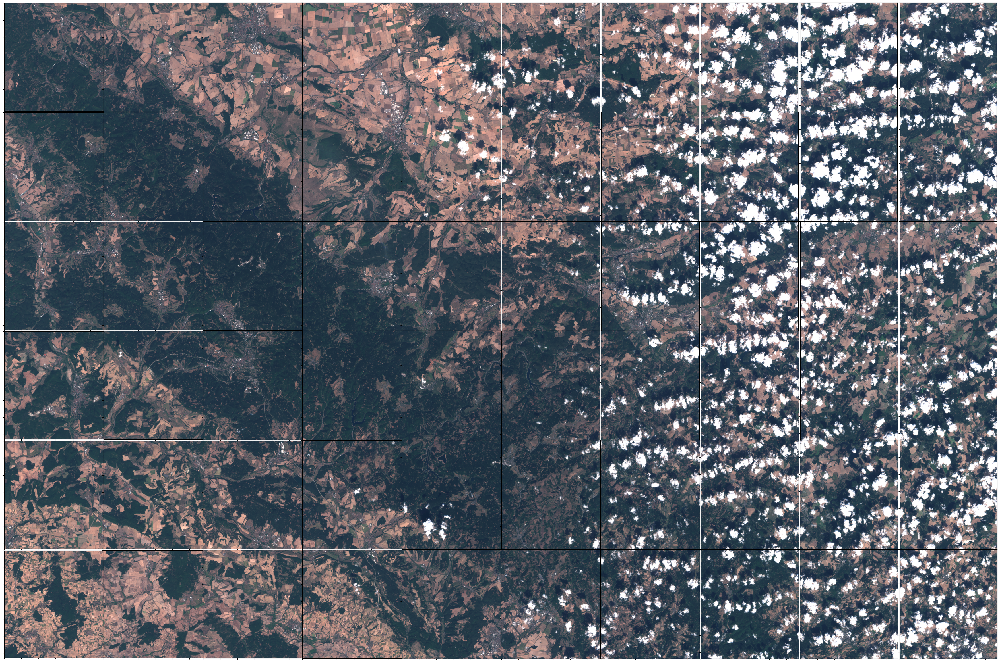

In [15]:
import matplotlib.pyplot as plt

plt.clf()

ratio = (bbox[2] - bbox[0]) / (bbox[3] - bbox[1])

size = 30

f, axarr = plt.subplots(6, 10, gridspec_kw = {'wspace':0, 'hspace':0}, figsize=(size * 1.503, size))

for ax in f.axes:
    #ax.grid('off')
    ax.set_xticklabels([])
    ax.set_yticklabels([])  


for i in range(10):
    for j in range(6):
        ax = axarr[j,i]
        #ax.grid('off')

        bbox = list(list_of_bbox[i,j,:])
        resolution = 10

        frankenwald_bbox = BBox(bbox=bbox, crs=CRS.WGS84)
        frankenwald_size = bbox_to_dimensions(frankenwald_bbox, resolution=resolution)
        request_true_color = SentinelHubRequest(
            data_folder="/home/josh/Desktop/S2_Frankenwald/",
            evalscript=evalscript_rgb,
            input_data=[
                SentinelHubRequest.input_data(
                    data_collection=DataCollection.SENTINEL2_L1C,
                    #mosaicking_order=MosaickingOrder.LEAST_CC,
                    time_interval=("2022-08-18", "2022-08-25"),
                )
            ],
            responses=[SentinelHubRequest.output_response("default", MimeType.TIFF)],
            bbox=frankenwald_bbox,
            size=frankenwald_size,
            config=config,)
        true_color_imgs = request_true_color.get_data(save_data=False)
        ax.imshow(true_color_imgs[0] / 255 * 3.5)
        #ax.set_aspect('equal')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        #text = ax.text(j, i, list_of_bbox[0,i,j],
        #    ha="center", va="center", color="k")  

What a beauty, isn't it?